<a href="https://colab.research.google.com/github/hal-yu/diabetes_readmission_project/blob/main/cleaning_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1. Importing Packages

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import csv
from lightgbm import LGBMClassifier
from sklearn.model_selection import train_test_split, cross_validate

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from catboost import CatBoostClassifier

import missingno as msno
import re

from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

ModuleNotFoundError: No module named 'catboost'

In [ ]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from sklearn.neighbors import KNeighborsClassifier

import plotly
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

import warnings
warnings.filterwarnings("ignore")

## 2. Loading Data

In [ ]:
# Using the ucimlrepo package to import datasets from the UC Irvine Machine Learning Repository
!pip install ucimlrepo

In [ ]:
# Link to dataset: https://archive.ics.uci.edu/dataset/296/diabetes+130-us+hospitals+for+years+1999-2008
# Loading the datasest into a pandas dataframe
from ucimlrepo import fetch_ucirepo

diabetes_130_us_hospitals_for_years_1999_2008 = fetch_ucirepo(id=296)

X = diabetes_130_us_hospitals_for_years_1999_2008.data.features
y = diabetes_130_us_hospitals_for_years_1999_2008.data.targets

# Metadata
print(diabetes_130_us_hospitals_for_years_1999_2008.metadata)

# Variable information
print(diabetes_130_us_hospitals_for_years_1999_2008.variables)

{'uci_id': 296, 'name': 'Diabetes 130-US Hospitals for Years 1999-2008', 'repository_url': 'https://archive.ics.uci.edu/dataset/296/diabetes+130-us+hospitals+for+years+1999-2008', 'data_url': 'https://archive.ics.uci.edu/static/public/296/data.csv', 'abstract': 'The dataset represents ten years (1999-2008) of clinical care at 130 US hospitals and integrated delivery networks. Each row concerns hospital records of patients diagnosed with diabetes, who underwent laboratory, medications, and stayed up to 14 days. The goal is to determine the early readmission of the patient within 30 days of discharge.\nThe problem is important for the following reasons. Despite high-quality evidence showing improved clinical outcomes for diabetic patients who receive various preventive and therapeutic interventions, many patients do not receive them. This can be partially attributed to arbitrary diabetes management in hospital environments, which fail to attend to glycemic control. Failure to provide pro

In [ ]:
# Examining the dataframe
# Note: Dataframe did not include 'readmitted' column
data = X
data

,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,payer_code,medical_specialty,...,examide,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed
0,Caucasian,Female,[0-10),NaN,6,25,1,1,NaN,Pediatrics-Endocrinology,...,No,No,No,No,No,No,No,No,No,No
1,Caucasian,Female,[10-20),NaN,1,1,7,3,NaN,NaN,...,No,No,Up,No,No,No,No,No,Ch,Yes
2,AfricanAmerican,Female,[20-30),NaN,1,1,7,2,NaN,NaN,...,No,No,No,No,No,No,No,No,No,Yes
3,Caucasian,Male,[30-40),NaN,1,1,7,2,NaN,NaN,...,No,No,Up,No,No,No,No,No,Ch,Yes
4,Caucasian,Male,[40-50),NaN,1,1,7,1,NaN,NaN,...,No,No,Steady,No,No,No,No,No,Ch,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101761,AfricanAmerican,Male,[70-80),NaN,1,3,7,3,MC,NaN,...,No,No,Down,No,No,No,No,No,Ch,Yes
101762,AfricanAmerican,Female,[80-90),NaN,1,4,5,5,MC,NaN,...,No,No,Steady,No,No,No,No,No,No,Yes
101763,Caucasian,Male,[70-80),NaN,1,1,7,1,MC,NaN,...,No,No,Down,No,No,No,No,No,Ch,Yes
101764,Caucasian,Female,[80-90),NaN,2,3,7,10,MC,Surgery-General,...,No,No,Up,No,No,No,No,No,Ch,Yes


In [ ]:
# Adding the 'readmitted' column to the dataframe
data['readmitted'] = y
data.head()

,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,payer_code,medical_specialty,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),NaN,6,25,1,1,NaN,Pediatrics-Endocrinology,...,No,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),NaN,1,1,7,3,NaN,NaN,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,AfricanAmerican,Female,[20-30),NaN,1,1,7,2,NaN,NaN,...,No,No,No,No,No,No,No,No,Yes,NO
3,Caucasian,Male,[30-40),NaN,1,1,7,2,NaN,NaN,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,Caucasian,Male,[40-50),NaN,1,1,7,1,NaN,NaN,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


In [ ]:
# Making a copy of the dataframe
df = data.copy()
df

,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,payer_code,medical_specialty,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),NaN,6,25,1,1,NaN,Pediatrics-Endocrinology,...,No,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),NaN,1,1,7,3,NaN,NaN,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,AfricanAmerican,Female,[20-30),NaN,1,1,7,2,NaN,NaN,...,No,No,No,No,No,No,No,No,Yes,NO
3,Caucasian,Male,[30-40),NaN,1,1,7,2,NaN,NaN,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,Caucasian,Male,[40-50),NaN,1,1,7,1,NaN,NaN,...,No,Steady,No,No,No,No,No,Ch,Yes,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101761,AfricanAmerican,Male,[70-80),NaN,1,3,7,3,MC,NaN,...,No,Down,No,No,No,No,No,Ch,Yes,>30
101762,AfricanAmerican,Female,[80-90),NaN,1,4,5,5,MC,NaN,...,No,Steady,No,No,No,No,No,No,Yes,NO
101763,Caucasian,Male,[70-80),NaN,1,1,7,1,MC,NaN,...,No,Down,No,No,No,No,No,Ch,Yes,NO
101764,Caucasian,Female,[80-90),NaN,2,3,7,10,MC,Surgery-General,...,No,Up,No,No,No,No,No,Ch,Yes,NO


## 3. Cleaning Data

### Handling Missing Values and Duplicate Values

In [ ]:
# Checking for the number of non-missing values for each column
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 48 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   race                      99493 non-null   object
 1   gender                    101766 non-null  object
 2   age                       101766 non-null  object
 3   weight                    3197 non-null    object
 4   admission_type_id         101766 non-null  int64 
 5   discharge_disposition_id  101766 non-null  int64 
 6   admission_source_id       101766 non-null  int64 
 7   time_in_hospital          101766 non-null  int64 
 8   payer_code                61510 non-null   object
 9   medical_specialty         51817 non-null   object
 10  num_lab_procedures        101766 non-null  int64 
 11  num_procedures            101766 non-null  int64 
 12  num_medications           101766 non-null  int64 
 13  number_outpatient         101766 non-null  int64 
 14  numb

In [ ]:
# Replacing "?" with NumPy's NaN
df = df.replace('?', np.nan)

In [ ]:
# Checking for the percentage of missing values for each column
def missing (df):
    missing_number = df.isnull().sum().sort_values(ascending=False)
    missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

missing(df)

,Missing_Number,Missing_Percent
weight,98569,0.968585
max_glu_serum,96420,0.947468
A1Cresult,84748,0.832773
medical_specialty,49949,0.490822
payer_code,40256,0.395574
race,2273,0.022336
diag_3,1423,0.013983
diag_2,358,0.003518
diag_1,21,0.000206
tolbutamide,0,0.000000


In [ ]:
# Dropping columns
# Note: Dataframe did not include 'encounter_id' and 'patient_nbr' columns
drop_columns = ['weight', 'diag_1', 'diag_2', 'diag_3', 'medical_specialty', 'payer_code', 'admission_source_id']
df = df.drop(columns=drop_columns)

In [ ]:
# Replacing missing values to 'Not Measured' in 'max_glu_serum' column
df['max_glu_serum'].replace(np.nan, 'Not Measured', inplace=True)
df['max_glu_serum'].head(10)

0    Not Measured
1    Not Measured
2    Not Measured
3    Not Measured
4    Not Measured
5    Not Measured
6    Not Measured
7    Not Measured
8    Not Measured
9    Not Measured
Name: max_glu_serum, dtype: object

In [ ]:
# Replacing missing values to 'Not Measured' in 'A1Cresult' column
df['A1Cresult'].replace(np.nan, 'Not Measured', inplace=True)
df['A1Cresult'].head(10)

0    Not Measured
1    Not Measured
2    Not Measured
3    Not Measured
4    Not Measured
5    Not Measured
6    Not Measured
7    Not Measured
8    Not Measured
9    Not Measured
Name: A1Cresult, dtype: object

In [ ]:
# Replacing missing values to 'Unknown' in 'race' column
df['race'].replace(np.nan, 'Unknown', inplace=True)
df['race'].head(10)

0          Caucasian
1          Caucasian
2    AfricanAmerican
3          Caucasian
4          Caucasian
5          Caucasian
6          Caucasian
7          Caucasian
8          Caucasian
9          Caucasian
Name: race, dtype: object

In [ ]:
# Drop Null/Unknown/Not Mapped values from Discharge Disposition and Admission Type

df = df[~df['discharge_disposition_id'].isin([18, 25, 26])]
df = df[~df['admission_type_id'].isin([5, 6, 8])]

In [ ]:
# Checking for duplicate values
df.duplicated().sum()

10

In [ ]:
# Dropping duplicate values
df = df.drop_duplicates()

In [ ]:
# Dropping rows
df = df.dropna()

## 4. Examining the Target Variable (Readmitted)

### Insights into Target Variable

In [ ]:
# Loking at the values of 'y'
y_readmitted = df['readmitted']
readmitted_value_counts = y_readmitted.value_counts(normalize=True)

# Calculating percentages
percentage_0 = round(readmitted_value_counts[0] * 100, 2)
percentage_1 = round(readmitted_value_counts[1] * 100, 2)
percentage_2 = round(readmitted_value_counts[2] * 100, 2)

# Viewing the results
print(f"Percentage of patients readmitted 'No': {percentage_0}% --> ({y_readmitted.value_counts()[0]} patients)")
print(f"Percentage of patients readmitted '<30': {percentage_1}% --> ({y_readmitted.value_counts()[1]} patients)")
print(f"Percentage of patients readmitted '>30': {percentage_2}% --> ({y_readmitted.value_counts()[2]} patients)")

Percentage of patients readmitted 'No': 54.06% --> (47390 patients)
Percentage of patients readmitted '<30': 34.77% --> (30483 patients)
Percentage of patients readmitted '>30': 11.16% --> (9786 patients)


Findings:
* Almost 54.06% of the instances of our target variable are not readmitted
* 47,390 patients did not get readmitted
* 34.77% of patients (30,483) were readmitted after less than 30 days (<30)
* 11.16% of patients (9,786) were readmitted after more than 30 days (>30)

### Visualizing the Target Variable

In [ ]:
# Creating a histogram for the 'readmitted' column
fig = px.histogram(df, x="readmitted", title='Readmitted', width=400, height=400)
fig.show()

## 5. Univariate Analysis: Numerical Features

In [ ]:
# Organizing the columns into categorical and numerical
categorical = ['race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum',
               'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride', 'acetohexamide', 'glipizide', 'glyburide',
               'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone', 'tolazamide', 'examide',
               'citoglipton', 'insulin', 'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone',
               'metformin-rosiglitazone', 'metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted']

numerical = ['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient',
             'number_emergency', 'number_inpatient', 'number_diagnoses']

### Descriptive Statistics

In [ ]:
# Conducting descriptive statistics for numerical
df[numerical].describe()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
count,87659.00000,87659.000000,87659.000000,87659.000000,87659.000000,87659.000000,87659.000000,87659.000000
mean,4.37866,43.433829,1.333383,15.985991,0.355138,0.206071,0.642706,7.497211
std,2.97299,19.443035,1.708600,8.119166,1.246727,0.970894,1.273274,1.921282
min,1.00000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
25%,2.00000,33.000000,0.000000,10.000000,0.000000,0.000000,0.000000,6.000000
50%,4.00000,44.000000,1.000000,15.000000,0.000000,0.000000,0.000000,9.000000
75%,6.00000,57.000000,2.000000,20.000000,0.000000,0.000000,1.000000,9.000000
max,14.00000,132.000000,6.000000,81.000000,42.000000,76.000000,21.000000,16.000000


### Skewness

In [ ]:
# Checking for the skew for numerical
df[numerical].skew()

time_in_hospital       1.144639
num_lab_procedures    -0.309428
num_procedures         1.326652
num_medications        1.333119
number_outpatient      8.834479
number_emergency      22.838952
number_inpatient       3.554149
number_diagnoses      -0.937800
dtype: float64

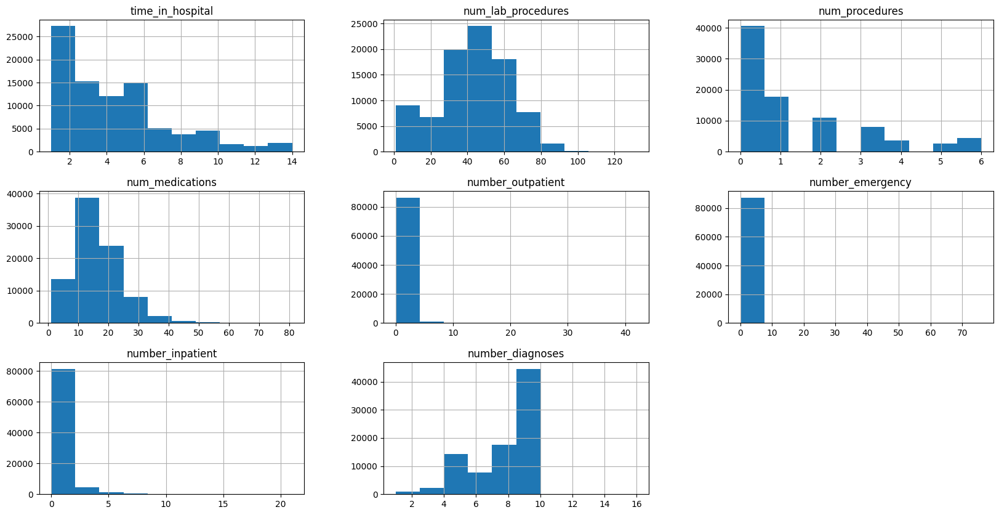

In [ ]:
# Creating histograms for numerical
df[numerical].hist(figsize=(20,10));

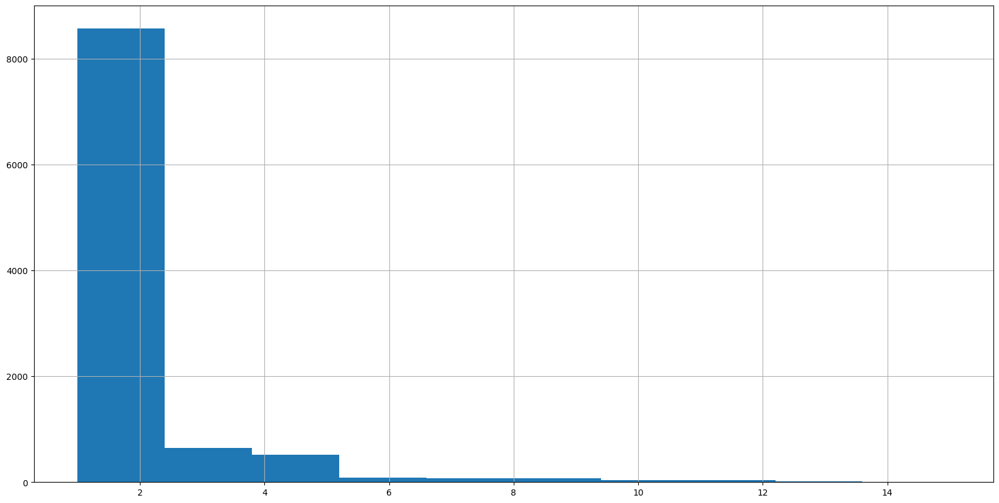

In [ ]:
# Creating a histogram for 'number_emergency' column
df['number_emergency'].hist(figsize=(20,10), range=[1,15]);

In [ ]:
# Obtaining the value counts for 'number_emergency' column
df['number_emergency'].value_counts()

number_emergency
0     77575
1      6808
2      1766
3       645
4       339
5       174
6        84
7        70
8        46
10       34
9        31
11       23
13       12
12       10
18        5
16        5
22        5
20        4
19        4
15        3
14        3
21        2
37        1
54        1
24        1
63        1
64        1
28        1
76        1
46        1
25        1
42        1
29        1
Name: count, dtype: int64

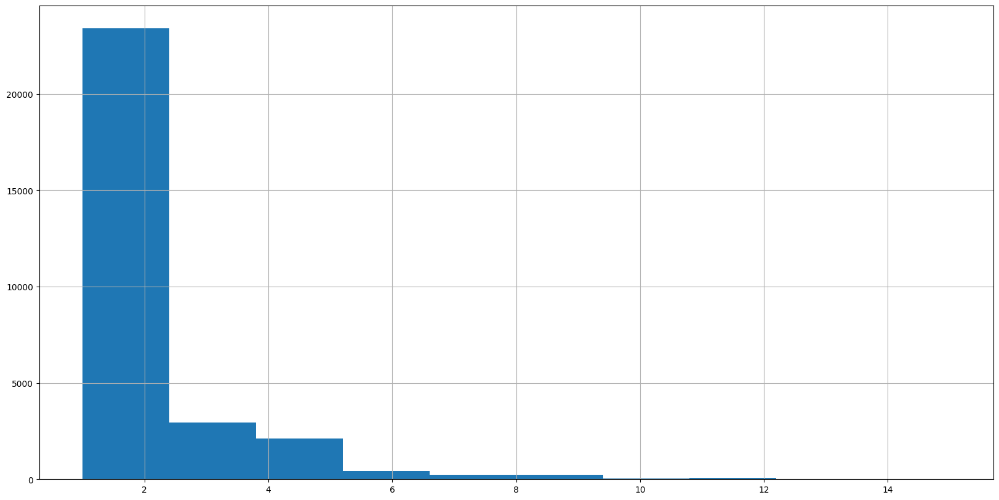

In [ ]:
# Creating a histogram for 'number_inpatient' column
df['number_inpatient'].hist(figsize=(20,10), range=[1,15]);

In [ ]:
# Obtaining the value counts for 'number_inpatient' column
df['number_inpatient'].value_counts()

number_inpatient
0     58080
1     16874
2      6534
3      2961
4      1414
5       714
6       424
7       245
8       138
9       101
10       55
11       48
12       32
13       19
14        8
15        7
16        2
21        1
18        1
19        1
Name: count, dtype: int64

<Axes: >

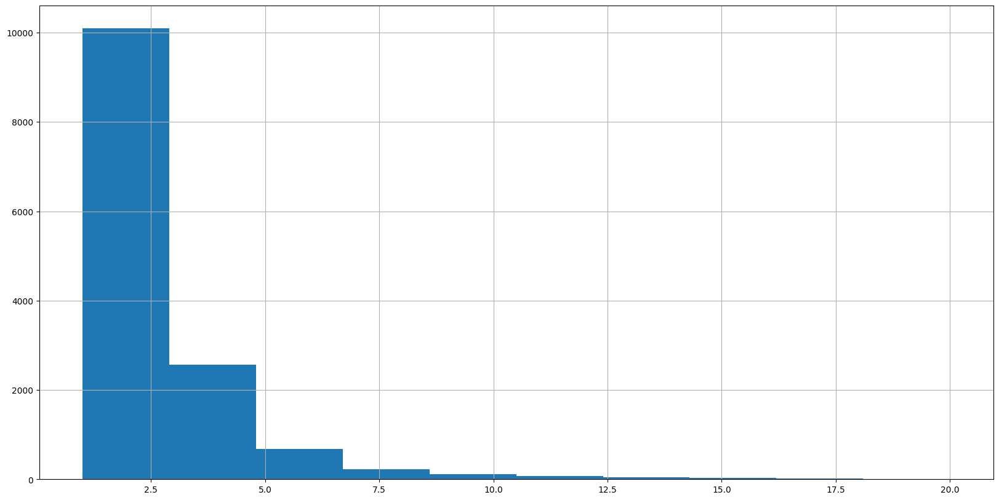

In [ ]:
# Creating a histogram for 'number_outpatient' column
df['number_outpatient'].hist(figsize=(20,10), range = [1,20])

In [ ]:
# Obtaining the value counts for 'number_outpatient' column
df['number_outpatient'].value_counts()

number_outpatient
0     73788
1      7165
2      2932
3      1657
4       903
5       422
6       251
7       137
8        87
9        69
10       49
11       38
12       29
13       27
14       21
15       19
16       14
17        7
21        6
20        6
18        4
22        4
19        3
24        3
23        2
25        2
33        2
26        2
34        1
39        1
42        1
35        1
29        1
28        1
27        1
37        1
38        1
40        1
Name: count, dtype: int64

In [ ]:
# Downloading the cleaned data as CSV for Tableau
df.to_csv('cleaned_diabetes.csv')

## 6. Univariate Analysis: Categorical Features

### Race

In [ ]:
# Creating a histogram for 'race' column
print (f'{round(df["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="race", title='Race', width=500, height=500)
fig.show()

race
Caucasian          74.17
AfricanAmerican    19.54
Unknown             2.43
Hispanic            1.75
Other               1.46
Asian               0.64
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'race' column
race_count = df['race'].value_counts()
print(race_count)

race
Caucasian          65021
AfricanAmerican    17127
Unknown             2128
Hispanic            1538
Other               1284
Asian                561
Name: count, dtype: int64


### Gender

In [ ]:
# Creating a histogram for 'gender' column
print (f'{round(df["gender"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="gender", title='Gender', width=500, height=500)
fig.show()

gender
Female             53.87
Male               46.13
Unknown/Invalid     0.00
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'gender' column
gender_count = df['gender'].value_counts()
print(gender_count)

gender
Female             47218
Male               40438
Unknown/Invalid        3
Name: count, dtype: int64


### Age

In [ ]:
# Creating a histogram for 'age' column
print (f'{round(df["age"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="age", title='Age', width=500, height=500)
fig.show()

age
[70-80)     25.20
[60-70)     22.25
[80-90)     17.03
[50-60)     16.99
[40-50)      9.44
[30-40)      3.73
[90-100)     2.77
[20-30)      1.69
[10-20)      0.73
[0-10)       0.17
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'age' column
age_count = df['age'].value_counts()
print(age_count)

age
[70-80)     22090
[60-70)     19502
[80-90)     14928
[50-60)     14896
[40-50)      8276
[30-40)      3271
[90-100)     2430
[20-30)      1480
[10-20)       639
[0-10)        147
Name: count, dtype: int64


### Admission Type ID

In [ ]:
# Creating a histogram for 'admission_type_id' column
print (f'{round(df["admission_type_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="admission_type_id", title='Admission Type ID', width=500, height=500)
fig.show()

admission_type_id
1    59.12
2    20.43
3    20.41
7     0.02
4     0.01
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'admission_type_id' column
admission_type_id_count = df['admission_type_id'].value_counts()
print(admission_type_id_count)

admission_type_id
1    51828
2    17912
3    17888
7       21
4       10
Name: count, dtype: int64


### Discharge Disposition ID

In [ ]:
# Creating a histogram for 'discharge_disposition_id' column
print (f'{round(df["discharge_disposition_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="discharge_disposition_id", title='Discharge Disposition ID', width=500, height=500)
fig.show()

discharge_disposition_id
1     62.89
3     13.76
6     12.99
22     2.21
2      2.13
11     1.69
5      1.19
4      0.91
7      0.64
13     0.44
23     0.43
14     0.33
28     0.12
8      0.11
15     0.07
24     0.05
9      0.02
19     0.01
27     0.01
12     0.00
17     0.00
20     0.00
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'discharge_disposition_id' column
discharge_disposition_id_count = df['discharge_disposition_id'].value_counts()
print(discharge_disposition_id_count)

discharge_disposition_id
1     55128
3     12063
6     11383
22     1941
2      1864
11     1484
5      1040
4       802
7       559
13      388
23      375
14      290
28      101
8        94
15       63
24       48
9        16
19        8
27        5
12        3
17        3
20        1
Name: count, dtype: int64


### A1C Results

In [ ]:
# Creating a histogram for 'A1Cresult' column
print (f'{round(df["A1Cresult"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="A1Cresult", title='A1C Results', width=500, height=500)
fig.show()

A1Cresult
Not Measured    83.08
>8               7.95
Norm             5.18
>7               3.78
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'A1Cresult' column
A1Cresult_count = df['A1Cresult'].value_counts()
print(A1Cresult_count)

A1Cresult
Not Measured    72830
>8               6972
Norm             4540
>7               3317
Name: count, dtype: int64


### Max Glucose Serum

In [ ]:
# Creating a histogram for 'max_glu_serum' column
print (f'{round(df["max_glu_serum"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="max_glu_serum", title='Max Glucose Serum', width=500, height=500)
fig.show()

max_glu_serum
Not Measured    98.75
Norm             0.59
>300             0.43
>200             0.22
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'max_glu_serum' column
max_glu_serum_count = df['max_glu_serum'].value_counts()
print(max_glu_serum_count)

max_glu_serum
Not Measured    86567
Norm              517
>300              379
>200              196
Name: count, dtype: int64


### Metformin

In [ ]:
# Creating a histogram for 'metformin' column
print (f'{round(df["metformin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="metformin", title='Metformin', width=500, height=500)
fig.show()

metformin
No        80.25
Steady    18.16
Up         1.03
Down       0.55
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'metformin' column
metformin_count = df['metformin'].value_counts()
print(metformin_count)

metformin
No        70349
Steady    15923
Up          904
Down        483
Name: count, dtype: int64


### Repaglinide

In [ ]:
# Creating a histogram for 'repaglinide' column
print (f'{round(df["repaglinide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="repaglinide", title='Repaglinide', width=500, height=500)
fig.show()

repaglinide
No        98.34
Steady     1.49
Up         0.12
Down       0.05
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'repaglinide' column
repaglinide_count = df['repaglinide'].value_counts()
print(repaglinide_count)

repaglinide
No        86203
Steady     1307
Up          107
Down         42
Name: count, dtype: int64


### Nateglinide

In [ ]:
# Creating a histogram for 'nateglinide' column
print (f'{round(df["nateglinide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="nateglinide", title='Nateglinide', width=500, height=500)
fig.show()

nateglinide
No        99.23
Steady     0.74
Up         0.03
Down       0.01
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'nateglinide' column
nateglinide_count = df['nateglinide'].value_counts()
print(nateglinide_count)

nateglinide
No        86981
Steady      646
Up           22
Down         10
Name: count, dtype: int64


### Chlorpropamide

In [ ]:
# Creating a histogram for 'chlorpropamide' column
print (f'{round(df["chlorpropamide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="chlorpropamide", title='Chlorpropamide', width=500, height=500)
fig.show()

chlorpropamide
No        99.94
Steady     0.05
Up         0.00
Down       0.00
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'chlorpropamide' column
chlorpropamide_count = df['chlorpropamide'].value_counts()
print(chlorpropamide_count)

chlorpropamide
No        87607
Steady       47
Up            4
Down          1
Name: count, dtype: int64


### Glimepiride

In [ ]:
# Creating a histogram for 'glimepiride' column
print (f'{round(df["glimepiride"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="glimepiride", title='Glimepiride', width=500, height=500)
fig.show()

glimepiride
No        94.53
Steady     4.94
Up         0.32
Down       0.20
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'glimepiride' column
glimepiride_count = df['glimepiride'].value_counts()
print(glimepiride_count)

glimepiride
No        82863
Steady     4334
Up          283
Down        179
Name: count, dtype: int64


### Acetohexamide

In [ ]:
# Creating a histogram for 'acetohexamide' column
print (f'{round(df["acetohexamide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="acetohexamide", title='Acetohexamide', width=500, height=500)
fig.show()

acetohexamide
No        100.0
Steady      0.0
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'acetohexamide' column
acetohexamide_count = df['acetohexamide'].value_counts()
print(acetohexamide_count)

acetohexamide
No        87658
Steady        1
Name: count, dtype: int64


### Glipizide

In [ ]:
# Creating a histogram for 'glipizide' column
print (f'{round(df["glipizide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="glipizide", title='Glipizide', width=500, height=500)
fig.show()

glipizide
No        87.44
Steady    11.28
Up         0.73
Down       0.55
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'glipizide' column
glipizide_count = df['glipizide'].value_counts()
print(glipizide_count)

glipizide
No        76650
Steady     9884
Up          643
Down        482
Name: count, dtype: int64


### Glyburide

In [ ]:
# Creating a histogram for 'glyburide' column
print (f'{round(df["glyburide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="glyburide", title='Glyburide', width=500, height=500)
fig.show()

glyburide
No        90.09
Steady     8.67
Up         0.75
Down       0.50
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'glyburide' column
glyburide_count = df['glyburide'].value_counts()
print(glyburide_count)

glyburide
No        78968
Steady     7596
Up          657
Down        438
Name: count, dtype: int64


### Tolbutamide

In [ ]:
# Creating a histogram for 'tolbutamide' column
print (f'{round(df["tolbutamide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="tolbutamide", title='Tolbutamide', width=500, height=500)
fig.show()

tolbutamide
No        99.98
Steady     0.02
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'tolbutamide' column
tolbutamide_count = df['tolbutamide'].value_counts()
print(tolbutamide_count)

tolbutamide
No        87642
Steady       17
Name: count, dtype: int64


### Pioglitazone

In [ ]:
# Creating a histogram for 'pioglitazone' column
print (f'{round(df["pioglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="pioglitazone", title='Pioglitazone', width=500, height=500)
fig.show()

pioglitazone
No        92.66
Steady     7.00
Up         0.23
Down       0.11
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'pioglitazone' column
pioglitazone_count = df['pioglitazone'].value_counts()
print(pioglitazone_count)

pioglitazone
No        81228
Steady     6136
Up          201
Down         94
Name: count, dtype: int64


### Rosiglitazone

In [ ]:
# Creating a histogram for 'rosiglitazone' column
print (f'{round(df["rosiglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="rosiglitazone", title='Rosiglitazone', width=500, height=500)
fig.show()

rosiglitazone
No        93.78
Steady     5.97
Up         0.17
Down       0.08
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'rosiglitazone' column
rosiglitazone_count = df['rosiglitazone'].value_counts()
print(rosiglitazone_count)

rosiglitazone
No        82207
Steady     5233
Up          152
Down         67
Name: count, dtype: int64


### Acarbose

In [ ]:
# Creating a histogram for 'acarbose' column
print (f'{round(df["acarbose"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="acarbose", title='Acarbose', width=500, height=500)
fig.show()

acarbose
No        99.71
Steady     0.28
Up         0.01
Down       0.00
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'acarbose' column
acarbose_count = df['acarbose'].value_counts()
print(acarbose_count)

acarbose
No        87402
Steady      247
Up            7
Down          3
Name: count, dtype: int64


### Miglitol

In [ ]:
# Creating a histogram for 'miglitol' column
print (f'{round(df["miglitol"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="miglitol", title='Miglitol', width=500, height=500)
fig.show()

miglitol
No        99.96
Steady     0.03
Down       0.01
Up         0.00
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'miglitol' column
miglitol_count = df['miglitol'].value_counts()
print(miglitol_count)

miglitol
No        87624
Steady       28
Down          5
Up            2
Name: count, dtype: int64


### Troglitazone

In [ ]:
# Creating a histogram for 'tropglitazone' column
print (f'{round(df["troglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="troglitazone", title='Troglitazone', width=500, height=500)
fig.show()

troglitazone
No        100.0
Steady      0.0
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'tropglitazone' column
troglitazone_count = df['troglitazone'].value_counts()
print(troglitazone_count)

troglitazone
No        87657
Steady        2
Name: count, dtype: int64


### Tolazamide

In [ ]:
# Creating a histogram for 'tolazamide' column
print (f'{round(df["tolazamide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="tolazamide", title='Tolazamide', width=500, height=500)
fig.show()

tolazamide
No        99.98
Steady     0.02
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'tolazamide' column
tolazamide_count = df['tolazamide'].value_counts()
print(tolazamide_count)

tolazamide
No        87640
Steady       19
Name: count, dtype: int64


### Examide

In [ ]:
# Creating a histogram for 'examide' column
print (f'{round(df["examide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="examide", title='Examide', width=500, height=500)
fig.show()

examide
No    100.0
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'examide' column
examide_count = df['examide'].value_counts()
print(examide_count)

examide
No    87659
Name: count, dtype: int64


### Citoglipton

In [ ]:
# Creating a histogram for 'citoglipton' column
print (f'{round(df["citoglipton"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="citoglipton", title='Citoglipton', width=500, height=500)
fig.show()

citoglipton
No    100.0
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'citoglipton' column
citoglipton_count = df['citoglipton'].value_counts()
print(citoglipton_count)

citoglipton
No    87659
Name: count, dtype: int64


### Insulin

In [ ]:
# Creating a histogram for 'insulin' column
print (f'{round(df["insulin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="insulin", title='Insulin', width=500, height=500)
fig.show()

insulin
No        44.98
Steady    31.39
Down      12.47
Up        11.15
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'insulin' column
insulin_count = df['insulin'].value_counts()
print(insulin_count)

insulin
No        39433
Steady    27519
Down      10933
Up         9774
Name: count, dtype: int64


### Glyburide-Metformin

In [ ]:
# Creating a histogram for 'glyburide-metformin' column
print (f'{round(df["glyburide-metformin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="glyburide-metformin", title='Glyburide-Metformin', width=500, height=500)
fig.show()

glyburide-metformin
No        99.20
Steady     0.78
Up         0.01
Down       0.01
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'glyburide-metformin' column
glyburide_metformin_count = df['glyburide-metformin'].value_counts()
print(glyburide_metformin_count)

glyburide-metformin
No        86961
Steady      685
Up            7
Down          6
Name: count, dtype: int64


### Glipizide-Metformin

In [ ]:
# Creating a histogram for 'glipizide-metformin' column
print (f'{round(df["glipizide-metformin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="glipizide-metformin", title='Glipizide-Metformin', width=500, height=500)
fig.show()

glipizide-metformin
No        99.99
Steady     0.01
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'glipizide-metformin' column
glipizide_metformin_count = df['glipizide-metformin'].value_counts()
print(glipizide_metformin_count)

glipizide-metformin
No        87646
Steady       13
Name: count, dtype: int64


### Glimepiride-Pioglitazone

In [ ]:
# Creating a histogram for 'glimepiride-pioglitazone' column
print (f'{round(df["glimepiride-pioglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="glimepiride-pioglitazone", title='Glimepiride-Pioglitazone', width=500, height=500)
fig.show()

glimepiride-pioglitazone
No        100.0
Steady      0.0
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'glimepiride-pioglitazone' column
glimepiride_pioglitazone_count = df['glimepiride-pioglitazone'].value_counts()
print(glimepiride_pioglitazone_count)

glimepiride-pioglitazone
No        87658
Steady        1
Name: count, dtype: int64


### Metformin-Rosiglitazone

In [ ]:
# Creating a histogram for 'metformin-rosiglitazone' column
print (f'{round(df["metformin-rosiglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="metformin-rosiglitazone", title='Metformin-Rosiglitazone', width=500, height=500)
fig.show()

metformin-rosiglitazone
No        100.0
Steady      0.0
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'metformin-rosiglitazone' column
metformin_rosiglitazone_count = df['metformin-rosiglitazone'].value_counts()
print(metformin_rosiglitazone_count)

metformin-rosiglitazone
No        87657
Steady        2
Name: count, dtype: int64


### Metformin-Pioglitazone

In [ ]:
# Creating a histogram for 'metformin-pioglitazone' column
print (f'{round(df["metformin-pioglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="metformin-pioglitazone", title='Metformin-Pioglitazone', width=500, height=500)
fig.show()

metformin-pioglitazone
No        100.0
Steady      0.0
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'metformin-pioglitazone' column
metformin_pioglitazone_count = df['metformin-pioglitazone'].value_counts()
print(metformin_pioglitazone_count)

metformin-pioglitazone
No        87658
Steady        1
Name: count, dtype: int64


### Change in Diabetic Medication

In [ ]:
# Creating a histogram for 'change' column
print (f'{round(df["change"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="change", title='Change in Diabetic Medication', width=500, height=500)
fig.show()

change
No    53.03
Ch    46.97
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'change' column
change_count = df['change'].value_counts()
print(change_count)

change
No    46484
Ch    41175
Name: count, dtype: int64


### Diabetes Medication Perscribed

In [ ]:
# Creating a histogram for 'diabetesMed' column
print (f'{round(df["diabetesMed"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(df, x="diabetesMed", title='Diabetes Medication Perscribed', width=500, height=500)
fig.show()

diabetesMed
Yes    77.71
No     22.29
Name: proportion, dtype: float64


In [ ]:
# Obtaining value counts for 'diabetesMed' column
diabetesMed_count = df['diabetesMed'].value_counts()
print(diabetesMed_count)

diabetesMed
Yes    68122
No     19537
Name: count, dtype: int64


## 7. Bivariate Analysis: Categorical/Numerical Features and Readmitted

In [ ]:
# Mapping values for 'readmitted' column
readmitted = {'NO': 0, '>30': 0, '<30': 1}
df['readmitted'] = df['readmitted'].map(readmitted)
df['readmitted']

1         0
2         0
3         0
4         0
5         0
         ..
101761    0
101762    0
101763    0
101764    0
101765    0
Name: readmitted, Length: 87659, dtype: int64

In [ ]:
# Keeping the most important categorical features based on the univariate analysis
categorical = ['race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id',
               'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin',
               'change', 'diabetesMed', 'readmitted']

In [ ]:
# Conducting a mutual info score
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, df['readmitted'])
df_cat = df[categorical].apply(cat_mut_inf)
df_cat = df_cat.sort_values(ascending=False).to_frame(name='mutual_info_score')
df_cat

,mutual_info_score
readmitted,0.349925
discharge_disposition_id,0.008105
insulin,0.000951
age,0.000689
diabetesMed,0.000378
metformin,0.000266
change,0.000260
A1Cresult,0.000236
race,0.000174
admission_type_id,0.000140


### Race and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'race'
races = df['race'].unique()

for race in races:
    print(f"A person of {race} race has a probability of {round(df[df['race'] == race]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person of Caucasian race has a probability of 11.36% to be readmitted
A person of AfricanAmerican race has a probability of 11.07% to be readmitted
A person of Unknown race has a probability of 8.22% to be readmitted
A person of Other race has a probability of 9.5% to be readmitted
A person of Asian race has a probability of 10.34% to be readmitted
A person of Hispanic race has a probability of 9.69% to be readmitted


In [ ]:
# Creating a histogram for 'race' column
fig = px.histogram(df, x="race", color="readmitted", width=600, height=400)
fig.show()

### Gender and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'gender'
genders = df['gender'].unique()

for gender in genders:
    print(f"A person that is {gender} has a probability of {round(df[df['gender'] == gender]['readmitted'].mean() * 100, 2)}% to be readmitted.")

A person that is Female has a probability of 11.22% to be readmitted.
A person that is Male has a probability of 11.09% to be readmitted.
A person that is Unknown/Invalid has a probability of 0.0% to be readmitted.


In [ ]:
# Creating a histogram for 'gender' column
fig = px.histogram(df, x="gender", color="readmitted", width=600, height=400)
fig.show()

### Age and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'age'
ages = df['age'].unique()

for age in ages:
    print(f"A person within the {age} age range has a probability of {round(df[df['age'] == age]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person within the [10-20) age range has a probability of 5.95% to be readmitted
A person within the [20-30) age range has a probability of 14.32% to be readmitted
A person within the [30-40) age range has a probability of 11.22% to be readmitted
A person within the [40-50) age range has a probability of 10.55% to be readmitted
A person within the [50-60) age range has a probability of 9.63% to be readmitted
A person within the [60-70) age range has a probability of 11.08% to be readmitted
A person within the [70-80) age range has a probability of 11.8% to be readmitted
A person within the [80-90) age range has a probability of 12.19% to be readmitted
A person within the [90-100) age range has a probability of 11.19% to be readmitted
A person within the [0-10) age range has a probability of 1.36% to be readmitted


In [ ]:
# Creating a histogram for 'age' column
fig = px.histogram(df, x="age", color="readmitted", width=600, height=400)
fig.show()

### Admission Type ID and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'admission_type_id'
admission_type_ids = df['admission_type_id'].unique()

for ATI in admission_type_ids:
    print(f"A person with an admission type ID of {ATI} has a probability of {round(df[df['admission_type_id'] == ATI]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person with an admission type ID of 1 has a probability of 11.47% to be readmitted
A person with an admission type ID of 2 has a probability of 11.19% to be readmitted
A person with an admission type ID of 3 has a probability of 10.27% to be readmitted
A person with an admission type ID of 4 has a probability of 10.0% to be readmitted
A person with an admission type ID of 7 has a probability of 0.0% to be readmitted


In [ ]:
# Creating a histogram for 'admission_type_id' column
fig = px.histogram(df, x="admission_type_id", color="readmitted", width=600, height=400)
fig.show()

### Discharge Disposition ID and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'discharge_disposition_id'
discharge_disposition_ids = df['discharge_disposition_id'].unique()

for DDI in discharge_disposition_ids:
    print(f"A person with a discharge disposition ID of {DDI} has a probability of {round(df[df['discharge_disposition_id'] == DDI]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person with a discharge disposition ID of 1 has a probability of 9.34% to be readmitted
A person with a discharge disposition ID of 3 has a probability of 14.63% to be readmitted
A person with a discharge disposition ID of 6 has a probability of 12.71% to be readmitted
A person with a discharge disposition ID of 2 has a probability of 16.9% to be readmitted
A person with a discharge disposition ID of 5 has a probability of 20.48% to be readmitted
A person with a discharge disposition ID of 11 has a probability of 0.0% to be readmitted
A person with a discharge disposition ID of 7 has a probability of 15.38% to be readmitted
A person with a discharge disposition ID of 4 has a probability of 12.59% to be readmitted
A person with a discharge disposition ID of 8 has a probability of 14.89% to be readmitted
A person with a discharge disposition ID of 14 has a probability of 6.55% to be readmitted
A person with a discharge disposition ID of 12 has a probability of 66.67% to be readmitted
A

In [ ]:
# Creating a histogram for 'discharge_disposition_id' column
fig = px.histogram(df, x="discharge_disposition_id", color="readmitted", width=600, height=400)
fig.show()

### A1C Results and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'A1Cresult'
A1Cresults = df['A1Cresult'].unique()

for A1C in A1Cresults:
    print(f"A person with an A1C result of {A1C} has a probability of {round(df[df['A1Cresult'] == A1C]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person with an A1C result of Not Measured has a probability of 11.46% to be readmitted
A person with an A1C result of >7 has a probability of 10.13% to be readmitted
A person with an A1C result of >8 has a probability of 9.58% to be readmitted
A person with an A1C result of Norm has a probability of 9.54% to be readmitted


In [ ]:
# Creating a histogram for 'A1Cresult' column
fig = px.histogram(df, x="A1Cresult", color="readmitted", width=600, height=400)
fig.show()

### Max Glucose Serum and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'max_glu_serum'
max_glu_serums = df['max_glu_serum'].unique()

for mgs in max_glu_serums:
    print(f"A person with a max glucose serum result of {mgs} has a probability of {round(df[df['max_glu_serum'] == mgs]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person with a max glucose serum result of Not Measured has a probability of 11.16% to be readmitted
A person with a max glucose serum result of >200 has a probability of 11.73% to be readmitted
A person with a max glucose serum result of Norm has a probability of 9.86% to be readmitted
A person with a max glucose serum result of >300 has a probability of 14.25% to be readmitted


In [ ]:
# Creating a histogram for 'max_glu_serum' column
fig = px.histogram(df, x="max_glu_serum", color="readmitted", width=600, height=400)
fig.show()

### Metformin and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'metformin'
metformins = df['metformin'].unique()

for metf in metformins:
    print(f"A person with {metf} dosage of metformin has a probability of {round(df[df['metformin'] == metf]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person with No dosage of metformin has a probability of 11.5% to be readmitted
A person with Steady dosage of metformin has a probability of 9.79% to be readmitted
A person with Up dosage of metformin has a probability of 8.52% to be readmitted
A person with Down dosage of metformin has a probability of 12.01% to be readmitted


In [ ]:
# Creating a histogram for 'metformin' column
fig = px.histogram(df, x="metformin", color="readmitted", width=600, height=400)
fig.show()

### Glipizide and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'glipizide'
glipizides = df['glipizide'].unique()

for glip in glipizides:
    print(f"A person with {glip} dosage of glipizide has a probability of {round(df[df['glipizide'] == glip]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person with No dosage of glipizide has a probability of 11.1% to be readmitted
A person with Steady dosage of glipizide has a probability of 11.3% to be readmitted
A person with Down dosage of glipizide has a probability of 15.56% to be readmitted
A person with Up dosage of glipizide has a probability of 12.91% to be readmitted


In [ ]:
# Creating a histogram for 'glipizide' column
fig = px.histogram(df, x="glipizide", color="readmitted", width=600, height=400)
fig.show()

### Glyburide and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'glyburide'
glyburides = df['glyburide'].unique()

for glyb in glyburides:
    print(f"A person with {glyb} dosage of glyburide has a probability of {round(df[df['glyburide'] == glyb]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person with No dosage of glyburide has a probability of 11.22% to be readmitted
A person with Steady dosage of glyburide has a probability of 10.72% to be readmitted
A person with Up dosage of glyburide has a probability of 10.5% to be readmitted
A person with Down dosage of glyburide has a probability of 9.36% to be readmitted


In [ ]:
# Creating a histogram for 'glyburide' column
fig = px.histogram(df, x="glyburide", color="readmitted", width=600, height=400)
fig.show()

In [ ]:
# Showing the probability of patients being readmitted by 'time_in_hospital'
time_in_hospital_values = sorted(df['time_in_hospital'].unique())

for time in time_in_hospital_values:
    print(f"A person who spent {time} day in the hospital has a probability of {round(df[df['time_in_hospital'] == time]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person who spent 1 day in the hospital has a probability of 8.04% to be readmitted
A person who spent 2 day in the hospital has a probability of 10.0% to be readmitted
A person who spent 3 day in the hospital has a probability of 10.79% to be readmitted
A person who spent 4 day in the hospital has a probability of 11.99% to be readmitted
A person who spent 5 day in the hospital has a probability of 12.21% to be readmitted
A person who spent 6 day in the hospital has a probability of 12.25% to be readmitted
A person who spent 7 day in the hospital has a probability of 12.76% to be readmitted
A person who spent 8 day in the hospital has a probability of 14.1% to be readmitted
A person who spent 9 day in the hospital has a probability of 13.41% to be readmitted
A person who spent 10 day in the hospital has a probability of 14.25% to be readmitted
A person who spent 11 day in the hospital has a probability of 10.5% to be readmitted
A person who spent 12 day in the hospital has a probabil

### Time in Hospital and Readmitted

In [ ]:
# Creating a histogram for 'time_in_hospital' column
fig = px.histogram(df, x="time_in_hospital", color="readmitted", width=600, height=400)
fig.show()

### Insulin and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'insulin'
insulins = df['insulin'].unique()

for insulin in insulins:
    print(f"A person with {insulin} dosage of insulin has a probability of {round(df[df['insulin'] == insulin]['readmitted'].mean() * 100, 2)}% of being readmitted")

A person with Up dosage of insulin has a probability of 12.94% of being readmitted
A person with No dosage of insulin has a probability of 10.0% of being readmitted
A person with Steady dosage of insulin has a probability of 11.09% of being readmitted
A person with Down dosage of insulin has a probability of 13.97% of being readmitted


In [ ]:
# Creating a histogram for 'insulin' column
fig = px.histogram(df, x="insulin", color="readmitted", width=600, height=400)
fig.show()

### Change in Diabetic Medication and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'changes'
changes = df['change'].unique()

for change in changes:
    print(f"A person with {change} change in diabetic medication has a probability of {round(df[df['change'] == change]['readmitted'].mean() * 100, 2)}% being readmitted")

A person with Ch change in diabetic medication has a probability of 11.93% being readmitted
A person with No change in diabetic medication has a probability of 10.49% being readmitted


In [ ]:
# Creating a histogram for 'changes' column
fig = px.histogram(df, x="change", color="readmitted", width=600, height=400)
fig.show()

### Diabetes Medication and Readmitted

In [ ]:
# Showing the probability of patients being readmitted by 'diabetesMed'
diabetesMeds = df['diabetesMed'].unique()

for diabetesMed in diabetesMeds:
    print(f"A person with {diabetesMed} diabetic medicaion prescribed has a probability of {round(df[df['diabetesMed'] == diabetesMed]['readmitted'].mean() * 100, 2)}% to be readmitted")

A person with Yes diabetic medicaion prescribed has a probability of 11.62% to be readmitted
A person with No diabetic medicaion prescribed has a probability of 9.57% to be readmitted


In [ ]:
# Creating a histogram for 'diabetesMed' column
fig = px.histogram(df, x="diabetesMed", color="readmitted", width=600, height=400)
fig.show()

## 8. Converting Categorical Features in Numeric Features

In [ ]:
# After conducting univariate analysis, bivariate analysis, and mutual info score, we decided to keep
# the following categorical features: 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult',
# 'max_glu_serum' 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', and 'diabetesMed'

# These columns will be remapped into numerical values

In [ ]:
# Dropping categorical features
df = df.drop(['repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride', 'acetohexamide', 'tolbutamide',
              'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone', 'tolazamide', 'examide',
              'citoglipton', 'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone',
              'metformin-rosiglitazone', 'metformin-pioglitazone'], axis = 1)

df.columns

Index(['race', 'gender', 'age', 'admission_type_id',
       'discharge_disposition_id', 'time_in_hospital', 'num_lab_procedures',
       'num_procedures', 'num_medications', 'number_outpatient',
       'number_emergency', 'number_inpatient', 'number_diagnoses',
       'max_glu_serum', 'A1Cresult', 'metformin', 'glipizide', 'glyburide',
       'insulin', 'change', 'diabetesMed', 'readmitted'],
      dtype='object')

### Race

In [ ]:
# Remapping 'race'
re_race = {
    'Unknown' : 0,
    'Caucasian' : 1,
    'AfricanAmerican' : 2,
    'Hispanic' : 3,
    'Asian' : 4,
    'Other' : 5
}

df['race'] = df['race'].map(re_race)

### Gender

In [ ]:
# Remapping 'gender'
re_gender = {
    'Female' : 2,
    'Male' : 1,
    'Unknown/Invalid' : 0
}

df['gender'] = df['gender'].map(re_gender)

### Age

In [ ]:
# Remapping 'age'
re_age = {
    '[90-100)' : 9,
    '[80-90)' : 8,
    '[70-80)' : 7,
    '[60-70)' : 6,
    '[50-60)' : 5,
    '[40-50)' : 4,
    '[30-40)' : 3,
    '[20-30)' : 2,
    '[10-20)' : 1,
    '[0-10)' : 0
}

df['age'] = df['age'].map(re_age)

### A1C Results

In [ ]:
# Remapping 'A1Cresult'
re_A1C = {">8" : 3,
          "Norm" : 1,
          ">7" : 2,
          "Not Measured" : 0
}

df['A1Cresult'] = df['A1Cresult'].map(re_A1C)

### Max Glucose Serum

In [ ]:
# Remapping 'max_glu_sreum'
re_maxglu = {"Norm" : 1,
             ">200" : 2,
             ">300" : 3,
            "Not Measured" : 0}

df['max_glu_serum'] = df['max_glu_serum'].map(re_maxglu)

### Metformin

In [ ]:
# Remapping 'metformin'
re_metformin = {"No" : 0,
                "Down" : 1,
                "Steady" : 2,
                "Up" : 3}

df['metformin'] = df['metformin'].map(re_metformin)

### Glipizide

In [ ]:
# Remapping 'glipizide'
re_glipizide = {"No": 0,
                "Down": 1,
                "Steady": 2,
                "Up": 3}

df['glipizide'] = df['glipizide'].map(re_glipizide)

### Glyburide

In [ ]:
# Remapping 'glyburide'
re_glyburide = {"No" : 0,
                "Down" : 1,
                "Steady" : 2,
                "Up" : 3}

df['glyburide'] = df['glyburide'].map(re_glyburide)

### Insulin

In [ ]:
# Remapping 'insulin'
re_insulin = {"No" : 0,
              "Down" : 1,
              "Steady" : 2,
              "Up" : 3}

df['insulin'] = df['insulin'].map(re_insulin)

### Changes in Medication

In [ ]:
# Remapping 'change'
re_change = {"No" : 0,
             "Ch" : 1}

df['change'] = df['change'].map(re_change)

### Diabetes Medication

In [ ]:
# Remapping 'diabetesMed'
re_diabetesMed = {"No" : 0,
                 "Yes" : 1}

df['diabetesMed'] = df['diabetesMed'].map(re_diabetesMed)

## 9. Training, Validating, and Testing Data

In [ ]:
# Breaking data up to train, validate, and test
train_df, valid_df, test_df = np.split(df.sample(frac=1, random_state=42),
                                       [int(.7*len(df)), int(0.85*len(df))])
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

In [ ]:
# Obtaining value counts of 'readmitted' column
df.readmitted.value_counts()

readmitted
0    77873
1     9786
Name: count, dtype: int64

In [ ]:
# Obtaining value counts of 'train_df'
train_df.readmitted.value_counts()

readmitted
0    54419
1     6942
Name: count, dtype: int64

In [ ]:
# Obtaining value counts of 'valid_df'
valid_df.readmitted.value_counts()

readmitted
0    11703
1     1446
Name: count, dtype: int64

In [ ]:
# Obtaining value counts of 'test_df'
test_df.readmitted.value_counts()

readmitted
0    11751
1     1398
Name: count, dtype: int64

## 10. Treating Imbalance in Data




In [ ]:
# Creating a calc_prevalance function
def calc_prevalence(y_actual):

    '''
    This function is to understand the ratio/distribution of the classes that we are going to predict for.

    Params:
    1. y_actual: The target feature

    Return:
    1. (sum(y_actual)/len(y_actual)): The ratio of the postive class in the comlpete data.
    '''

    return (sum(y_actual)/len(y_actual))

In [ ]:
# Splitting the training data into positive and negative
rows_pos = train_df.readmitted == 1
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

# Merging the data into balanced dataset
df_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)],axis = 0)

# Shuffling the order of training samples
df_df_balanced = df_df_balanced.sample(n = len(df_df_balanced), random_state = 42).reset_index(drop = True)

print('Train balanced prevalence(n = %d):%.3f'%(len(df_df_balanced), \
                                                calc_prevalence(df_df_balanced.readmitted.values)))

Train balanced prevalence(n = 13884):0.500


In [ ]:
# Obtaining value counts of 'df_df_balanced'
df_df_balanced.readmitted.value_counts()

readmitted
1    6942
0    6942
Name: count, dtype: int64

In [ ]:
# Scaling the data
X_train = df_df_balanced.drop('readmitted', axis=1)

y_train = df_df_balanced['readmitted']

X_valid = valid_df.drop('readmitted', axis=1)

y_valid = valid_df['readmitted']

X_test = test_df.drop('readmitted', axis=1)

y_test = test_df['readmitted']

scaler=StandardScaler()
X_train[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed']] = pd.DataFrame(scaler.fit_transform(X_train[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed'])
X_valid[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed']] = pd.DataFrame(scaler.transform(X_valid[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed'])
X_test[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed']] = pd.DataFrame(scaler.transform(X_test[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'race', 'gender', 'age', 'admission_type_id', 'discharge_disposition_id', 'A1Cresult', 'max_glu_serum', 'metformin', 'glipizide', 'glyburide', 'insulin', 'change', 'diabetesMed'])

## 11. Creating and Understanding Models

In [ ]:
# Creating the calc_specificity function
def calc_specificity(y_actual, y_pred, thresh):
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual ==0)

def print_report(y_actual, y_pred, thresh = 0.5):

    '''
    This function calculates all the metrics to asses the machine learning models.

    Params:
    1. y_actual: The actual values for the target variable.
    2. y_pred: The predicted values for the target variable.
    3. thresh: The threshold for the probability to be considered as a positive class. Default value 0.5

    Return:
    1. AUC
    2. Accuracy
    3. Recall
    4. Precision
    5. Specificity
    '''

    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

## 12. Regressions

### Linear Regression

In [ ]:
# Conducting linear regression
lnr = LinearRegression()
lnr.fit(X_train, y_train)

y_valid_preds = lnr.predict(X_valid)
y_valid_preds

array([0.45801562, 0.46891871, 0.43693499, ..., 0.71641316, 0.44838132,
       0.49159157])

### Logistic Regression

In [ ]:
# Conducting logistic regression
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train, y_train)

y_valid_preds = lr.predict_proba(X_valid)[:,1]

print('Metrics for Validation data:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

Metrics for Validation data:
AUC:0.631
accuracy:0.663
recall:0.485
precision:0.160
specificity:0.685
prevalence:0.110
 


## 13. Models

### KNN Model

In [ ]:
# Creating a KNN Model
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train, y_train)

knn_preds = knn.predict_proba(X_valid)[:,1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
 lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)

AUC:0.613
accuracy:0.629
recall:0.513
precision:0.151
specificity:0.597
prevalence:0.110
 


### Stochastic Gradient Descent Model

In [ ]:
# Creating a Stochastic Gradient Descent Model
sgdc=SGDClassifier(loss = 'log_loss',alpha = 0.1,random_state = 42)
sgdc.fit(X_train, y_train)

sgd_preds = sgdc.predict_proba(X_valid)[:,1]

print('Stochastic Gradient Descent')
print('Validation:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
                sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)

Stochastic Gradient Descent
Validation:
AUC:0.627
accuracy:0.649
recall:0.501
precision:0.157
specificity:0.667
prevalence:0.110
 


### Decision Tree Model

In [ ]:
# Creating a Decision Tree Model
dc_clf = DecisionTreeClassifier(random_state=42, max_depth = 10)
dc_clf.fit(X_train, y_train)

dc_preds_proba = dc_clf.predict_proba(X_valid)[:,1]
dc_preds = dc_clf.predict(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,dc_preds_proba, 0.5)

AUC:0.619
accuracy:0.613
recall:0.583
precision:0.158
specificity:0.612
prevalence:0.110
 


### Random Forest Model

In [ ]:
# Creating a Random Forest Model
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)

rf_clf.fit(X_train, y_train)

rf_preds = rf_clf.predict(X_valid)
rf_preds_proba = rf_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,rf_preds_proba, 0.5)

AUC:0.652
accuracy:0.611
recall:0.596
precision:0.160
specificity:0.612
prevalence:0.110
 


### Linear SVC Model

In [ ]:
# Creating a Linear SVC Model
lsvc_clf = LinearSVC(random_state=111)
lsvc_clf.fit(X_train, y_train)

lsvc_preds = lsvc_clf.decision_function(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,lsvc_preds, 0.5)

AUC:0.629
accuracy:0.882
recall:0.086
precision:0.353
specificity:0.981
prevalence:0.110
 


### Gradient Boosting Model

In [ ]:
# Creating a Gradient Boosting Model
gb_clf = GradientBoostingClassifier(n_estimators = 100, criterion='friedman_mse', learning_rate = 1.0, max_depth = 3,\
                                    random_state = 111)

gb_clf.fit(X_train, y_train)
gb_preds = gb_clf.predict(X_valid)
gb_preds_proba = gb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,gb_preds_proba, 0.5)

AUC:0.636
accuracy:0.611
recall:0.585
precision:0.158
specificity:0.614
prevalence:0.110
 


### XGB Model

In [ ]:
# Creating a XGB Model
xgb_clf = xgb.XGBClassifier(max_depth=3, learning_rate = 1.0, use_label_encoder = False,\
                            eval_metric = 'logloss')
X_train = X_train.to_numpy()
y_train = y_train.to_numpy()

xgb_clf.fit(X_train, y_train)

xgb_preds = xgb_clf.predict(X_valid)
xgb_preds_proba = xgb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,xgb_preds_proba, 0.5)

AUC:0.638
accuracy:0.612
recall:0.582
precision:0.158
specificity:0.616
prevalence:0.110
 


### Catboost Model

In [ ]:
# Creating a Catboost Model
catb=CatBoostClassifier(iterations=200, depth=3, learning_rate=1.0, random_state = 111)
catb.fit(X_train, y_train)
catb_preds = catb.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,catb_preds, 0.5)

NameError: name 'CatBoostClassifier' is not defined

## 14. Models: Hyper Parameter Tuning

In [ ]:
# Creating the recall score function
recall_scoring = make_scorer(recall_score)

### Decision Tree Model

In [ ]:
# Creating a Decision Tree Model with hyper-parameter tuning
dc_grid = {'max_features':['auto','sqrt'],
           'max_depth':range(1,11,1),
           'min_samples_split':range(2,10,2),
           'criterion':['gini','entropy']}

dc_random = RandomizedSearchCV(estimator = dc_clf, param_distributions = dc_grid,
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

dc_random.fit(X_train, y_train)

dc_random.best_params_

dc_hp_preds = dc_random.best_estimator_.predict(X_valid)
dc_hp_preds_proba = dc_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, dc_hp_preds_proba)

In [ ]:
recall_score(y_valid, dc_hp_preds)

### Random Forest Model

In [ ]:
# Creating a Random Forest Model with hyper-parameter tuning
rf_grid = {'n_estimators':range(200,1000,200),
           'max_features':['auto','sqrt'],
           'max_depth':range(1,11,1),
           'min_samples_split':range(2,10,2),
           'criterion':['gini','entropy']}

rf_random = RandomizedSearchCV(estimator = rf_clf, param_distributions = rf_grid,
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

rf_random.fit(X_train, y_train)

rf_random.best_params_

rf_hp_preds = rf_random.best_estimator_.predict(X_valid)
rf_hp_preds_proba = rf_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, rf_hp_preds_proba)

In [ ]:
recall_score(y_valid, rf_hp_preds)

### XGBoost Model

In [ ]:
# Creating a XGBoost Model with hyper-parameter tuning
xgb_grid = params = {
        'min_child_weight': [1, 5, 8, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 0.9, 1.0],
        'max_depth': [3, 4, 5]
        } # criterion for evaluating a split

xgb_random = GridSearchCV(estimator = xgb_clf, param_grid = xgb_grid,
                               cv = 2, scoring = recall_scoring,
                               verbose = 1)

xgb_random.fit(X_train, y_train)

xgb_random.best_params_

xgb_hp_preds = xgb_random.best_estimator_.predict(X_valid)
xgb_hp_preds_proba = xgb_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, xgb_hp_preds_proba)

In [ ]:
recall_score(y_valid, xgb_hp_preds)

### Comparing Hyper Parameter Tuning Model Results

Decision Tree:
* AUC: 0.5249
* Recall: 0.5735

Random Forest:
* AUC: 0.6424
* Recall: 0.6551

XGBoost
* AUC: 0.6550
* Recall: 0.6245

Summary:
* For AUC: XGBoost (0.6522) > Random Forest (0.6488) > Decision Tree (0.5605)
* Recall: Decision Tree (0.7654) > Random Forest (0.6404) > Random Forest (0.6023)